> Projeto Desenvolve <br>
Programação Intermediária com Python <br>
Profa. Camila Laranjeira (mila@projetodesenvolve.com.br) <br>

# 4.2 - APIs


## Exercícios 🔭🌌🪐

Vamos acessar as APIs da NASA para ver algumas imagens interessantes capturadas universo afora!

#### Q1.
Crie uma chave no site oficial:
* https://api.nasa.gov

Vamos armazenar a chave de forma segura! <br>
Salve a sua chave em um arquivo `key.json` na forma:
`API_KEY=SUA_CHAVE`

Adicione o nome do arquivo `key.json` ao `.gitignore` do repositório que você fará upload da atividade.
Para isso basta abrir o arquivo `.gitignore` na pasta raíz do repositório (ou criar um caso ele não exista). Dentro do arquivo, apenas adiciona o nome do arquivo que deseja ignorar.

#### Q2. 🛰 Astronomy Picture of the Day (APOD) 🌌
> Antes de fazer os exercícios, devo te lembrar que existem limites de acesso às APIs, descritas na página principal, portanto pega leve na tentativa e erro na hora de testar seu código.

<img width=500 src=https://apod.nasa.gov/apod/image/2407/M24-HaLRGB-RC51_1024.jpg>

A primeira API que acessaremos é a mais popular de todas: astronomy picture of the day (foto astronômica do dia).

Faça uma requisição GET para a URL da API que retorna a imagem do dia! Essa é fácil já que são os valores padrão da rota principal:
* URL base: `'https://api.nasa.gov/planetary/apod'`
* Endpoint: não precisa preencher, acessaremos a raíz da API.
* Query params: preencha `api_key` com a sua chave de autenticação. Se animar mexer em outros parâmetros veja [a documentação](https://api.nasa.gov).

Ao receber a resposta (um json), você deve:
* Imprimir os campos `copyright` e `explanation`
* Com as biblioteca scikit-images e matplotlib, apresente a imagem a partir do campo `url` ou `hdurl`, e preencha o título do plot com o campo `title` do json. Uma dica de código a seguir.
```python
from skimage import io
img = io.imread(url)
## plot a matriz img com matplotlib (imshow)
```   


Josh Dury

Why were the statues on Easter Island built?  No one is sure.  What is sure is that over 900 large stone statues called moais exist there.  The Rapa Nui (Easter Island) moais stand, on average, over twice as tall as a person and have over 200 times as much mass.  It is thought that the unusual statues were created about 600 years ago in the images of local leaders of a vibrant and ancient civilization.  Rapa Nui has been declared by UNESCO to a World Heritage Site. Pictured here, some of the stone giants were imaged last month under the central band of our Milky Way galaxy.  Previously unknown moais are still being discovered.    Alternative Multi-APOD Front Page: MyUniverseHub.com


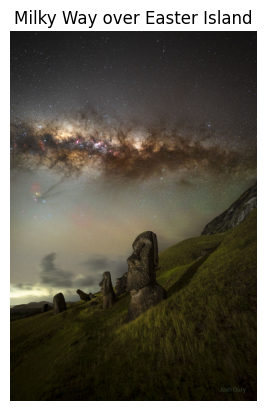

In [25]:
import json
import requests
from skimage import io
import matplotlib.pyplot as plt

with open("key.json") as f:
    key = json.load(f)['API_KEY']

url = "https://api.nasa.gov/planetary/apod"
params = {'api_key': key}

response = requests.get(url, params=params)

if response.status_code == 200:
    data = response.json()
    print(data.get('copyright','N/A'))
    print(data['explanation'])

    image_url = data.get('hdurl', data.get('url'))
    img = io.imread(image_url)
    plt.imshow(img)
    plt.title(data['title'])
    plt.axis('off')
    plt.show()

else:
  print(f"Erro na solicitação. Código de status: {response.status_code}")





#### Q3. Limites
A partir da resposta da query anterios, imprima o header da resposta e consulte os atributos:
* X-RateLimit-Limit: o limite total de requisições da sua chave de API
* X-RateLimit-Remaining: o limite restante de requisições da sua chave de API

In [26]:
if response.status_code == 200:
    print(response.headers)
    rate_limit = response.headers.get('X-RateLimit-Limit')
    rate_remaining = response.headers.get('X-RateLimit-Remaining')

    print(f"Limite total de requisições: {rate_limit}")
    print(f"Limite restante de requisições: {rate_remaining}")


else:
    print(f"Erro na solicitação. Código de status: {response.status_code}")

{'Date': 'Tue, 05 Nov 2024 13:48:08 GMT', 'Content-Type': 'application/json', 'Transfer-Encoding': 'chunked', 'Connection': 'keep-alive', 'Vary': 'Accept-Encoding', 'Access-Control-Allow-Origin': '*', 'Access-Control-Expose-Headers': 'X-RateLimit-Limit, X-RateLimit-Remaining', 'Age': '0', 'Strict-Transport-Security': 'max-age=31536000; includeSubDomains; preload', 'Via': 'https/1.1 api-umbrella (ApacheTrafficServer [cMsSf ])', 'X-Api-Umbrella-Request-Id': 'civiaj2gnf045t9l5o70', 'X-Cache': 'MISS', 'X-Content-Type-Options': 'nosniff', 'X-Ratelimit-Limit': '2000', 'X-Ratelimit-Remaining': '1984', 'X-Vcap-Request-Id': 'e2f1b7ea-c63b-4386-789c-6f97a6ccb28b', 'X-Xss-Protection': '1; mode=block', 'X-Frame-Options': 'DENY', 'Content-Encoding': 'gzip'}
Limite total de requisições: 2000
Limite restante de requisições: 1984


### Q4. Mars Rover Photos 🚀🚙 📷

<img width=500 src=https://www.nasa.gov/wp-content/uploads/2019/10/pia23378-16.jpg>

Essa API retorna dados (incluindo imagens capturadas) sobre os veículos que hoje habitam o planeta Marte. São os rovers `opportunity`, `spirit` e o mais famoso, o `curiosity` (da foto acima).

Antes de requisitar imagens, vamos ver o relatório de dados coletados por um deles, o `curiosity`. Isso vai nos ajudar a montar a query de imagens coletadas.

Faça uma requisição GET para a seguinte URL:
* URL base: `'https://api.nasa.gov/mars-photos/api/v1'`
* endpoint: `'/manifests/{nome_do_rover}'`
* query parameters: preencha `api_key` com a sua chave de autenticação.

Extraia o json da resposta retornada. O campo principal é o `'photo_manifest'`, do qual queremos acessar os seguintes valores:
* `max_sol`: Máximo "dia marciano" de coleta de fotos. O dia marciano tem 24 horas, 39 minutos e 35 segundos.
* `max_date`: Última data terrestre de coleta de fotos, na forma `'aaaa-mm-dd'`.

Imprima esses dois atributos da resposta e os use no próximo exercício para coletar as fotos mais recentes tiradas.

In [21]:
url = "https://api.nasa.gov/mars-photos/api/v1/manifests/curiosity"
params = {'api_key': key}


response = requests.get(url, params=params)

if response.status_code == 200:
    data = response.json()
    photo_manifest = data.get('photo_manifest',{})
    max_sol = photo_manifest.get('max_sol', 'N/A')
    max_date = photo_manifest.get('max_date', 'N/A')
    print(f"Máximo dia marciano de coleta: {max_sol}")
    print(f"Última data terrestre de coleta: {max_date}")

else:
    print(f"Erro na solicitação. Código de status: {response.status_code}")

Erro na solicitação. Código de status: 500


#### Q5.

Faça uma requisição GET para a URL da API que retorna links para as imagens coletadas pelos rovers.

* URL base: `'https://api.nasa.gov/mars-photos/api/v1'`
* Endpoint: `/rovers/{nome_do_rover}/photos`
* Query params sugeridos:
    * `api_key`: sua chave de autenticação.
    * `sol`: dia marciano que deseja coletar (de 0 a `max_sol` coletado anteriormente)
    * `page`: você pode paginar entre as respostas! São retornados 25 resultados por página.

A resposta esperada estará no formato a seguir, uma lista no campo `'photos'` onde cada item é um dicionário com os dados da foto tirada. Dentre os dados há o campo `camera` indicando qual das câmeras do rover tirou a foto. As fotos mais interessantes (na minha opinião, claro) são das câmeras de navegação (`"name": "NAVCAM"`) e as de prevenção de colisão (frente: `"name": "FHAZ"` e trás `"name": "RHAZ"`) onde dá pra ver partes do robô!

**Seu trabalho é**:
* Paginar a requisição acima até que a resposta seja `None`
* Escolher uma ou mais câmeras (ex: `NAVCAM`, `FHAZ`, `RHAZ`), e em um laço de repetição plotar todas as imagens retornadas daquela câmera. Use novamente as bibliotecas scikit-image e matplotlib.
  * O título da imagem deve ter a página da requisição, nome da câmera e id da imagem.

```json
{
  "photos": [
    {
      "id": 1228212,
      "sol": 4102,
      "camera": {
        "id": 20,
        "name": "FHAZ",
        "rover_id": 5,
        "full_name": "Front Hazard Avoidance Camera"
      },
      "img_src": "https://mars.nasa.gov/msl-raw-images/proj/msl/redops/ods/surface/sol/04102/opgs/edr/fcam/FLB_761645828EDR_F1060660FHAZ00302M_.JPG",
      "earth_date": "2024-02-19",
      "rover": {
        "id": 5,
        "name": "Curiosity",
        ...
      }
    }
    {
      "id": 1228213,
      "sol": 4102,
      ...
    }
```



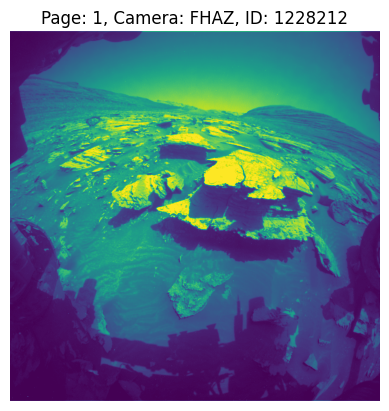

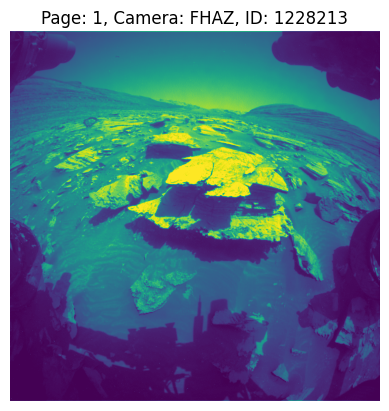

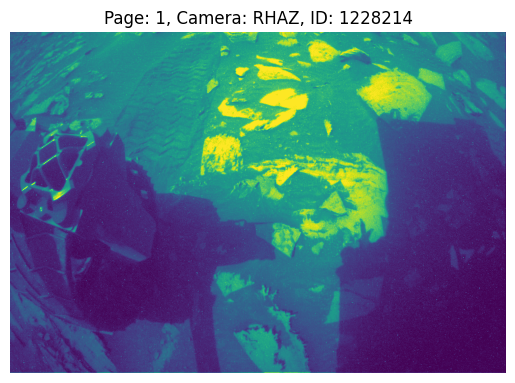

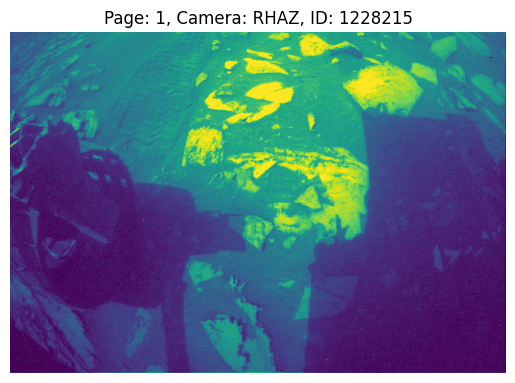

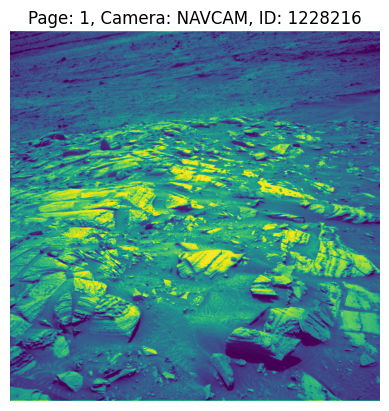

...

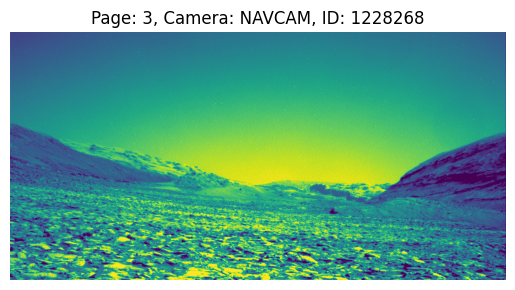

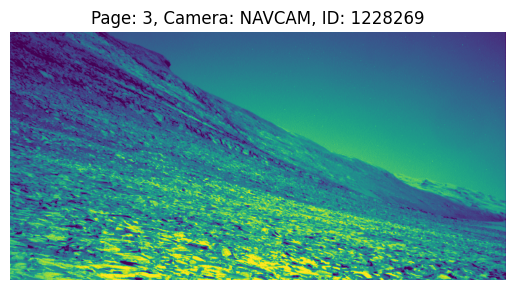

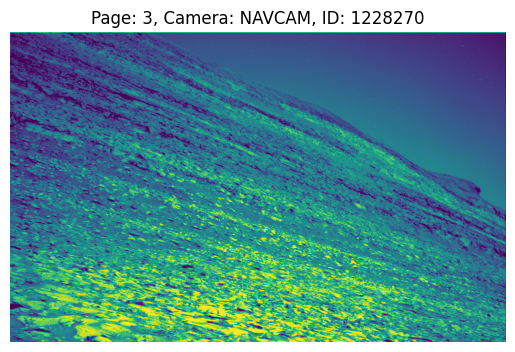

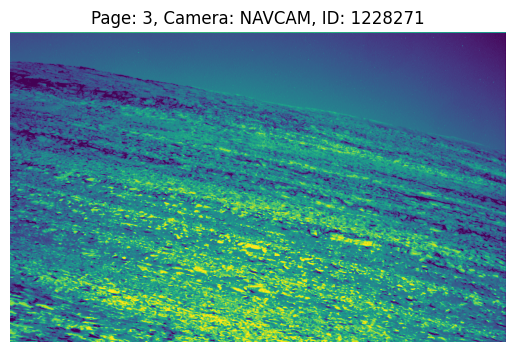

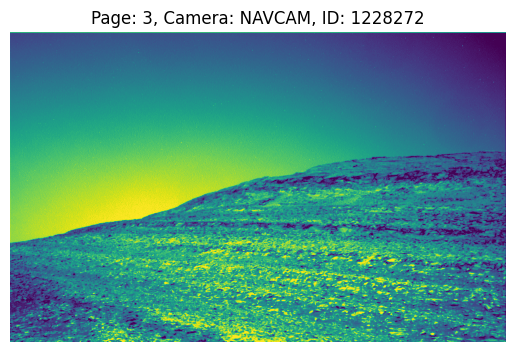

In [31]:
rover_name= 'curiosity'
api_key = key
sol = max_sol
page = 1

while True:
    url = f"https://api.nasa.gov/mars-photos/api/v1/rovers/{rover_name}/photos"
    params = {'api_key': api_key, 'sol': sol, 'page': page}

    response = requests.get(url, params=params)
    if response.status_code != 200:
        print(f"Erro na solicitação. Código de status: {response.status_code}")
        break

    # Extraindo dados
    data = response.json()
    photos = data.get('photos', [])

    # Se não houver mais fotos, saia do loop
    if not photos:
        break

    # Filtrando fotos pela câmera desejada
    selected_camera_names = ["NAVCAM", "FHAZ", "RHAZ"]  # Câmeras desejadas
    for photo in photos:
        camera_name = photo['camera']['name']
        if camera_name in selected_camera_names:
            img_src = photo['img_src']
            img_id = photo['id']

            # Lendo a imagem
            img = io.imread(img_src)

            # Plotando a imagem
            plt.imshow(img)
            plt.title(f'Page: {page}, Camera: {camera_name}, ID: {img_id}')
            plt.axis('off')  # Desativa os eixos
            plt.show()

    # Avança para a próxima página
    page += 1